# Import of libraries

In [2]:
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

In [3]:
sns.set_context("poster")
sns.set(rc={"figure.figsize": (12.,6.)})
sns.set_style("whitegrid")

# Context

Coronavirus disease (COVID-19) is an infectious disease caused by a newly discovered coronavirus. Most people infected with COVID-19 virus will experience mild to moderate respiratory illness and recover without requiring special treatment. Older people, and those with underlying medical problems like cardiovascular disease, diabetes, chronic respiratory disease, and cancer are more likely to develop serious illness.
During the entire course of the pandemic, one of the main problems that healthcare providers have faced is the shortage of medical resources and a proper plan to efficiently distribute them. In these tough times, being able to predict what kind of resource an individual might require at the time of being tested positive or even before that will be of immense help to the authorities as they would be able to procure and arrange for the resources necessary to save the life of that patient.

The main goal of this project is to build a machine learning model that, given a Covid-19 patient's current symptom, status, and medical history, will predict whether the patient is in high risk or not.

## Source

The dataset was provided by the Mexican government: https://datos.gob.mx/busca/dataset/informacion-referente-a-casos-covid-19-en-mexico

    12 types of medical units in Mexico 
    published on: 2020-04-14T00:28:50Z
    12 month dont data of Mexico citizens 
    by: Subdirector de Notificación y Registros Epidemiológicos.
    	hector.paredes@salud.gob.mx
    Document is updated monthly.
    
Information from the Epidemiological Surveillance System of Viral Respiratory Diseases.

Note: Preliminary data subject to validation by the Ministry of Health through the General Directorate of Epidemiology. The information contained corresponds solely to the data obtained from the epidemiological study of a suspected case of viral respiratory disease at the time it is identified in the medical units of the Health Sector.

According to the clinical diagnosis on admission, it is considered as an outpatient or hospitalized. The database does not include the evolution during their stay in the medical units, with the exception of updates upon discharge by hospital epidemiological surveillance units or health jurisdictions in the case of deaths.

# Content

The dataset was provided by the Mexican government (link). This dataset contains an enormous number of anonymized patient-related information including pre-conditions. The raw dataset consists of 21 unique features and 1,048,576 unique patients. In the Boolean features, 1 means "yes" and 2 means "no". values as 97 and 99 are missing data.

    sex: 1 for female and 2 for male.
    age: of the patient.
    classification: covid test findings. Values 1-3 mean that the patient was diagnosed with covid in different
    degrees. 4 or higher means that the patient is not a carrier of covid or that the test is inconclusive.
    patient type: type of care the patient received in the unit. 1 for returned home and 2 for hospitalization.
    pneumonia: whether the patient already have air sacs inflammation or not.
    pregnancy: whether the patient is pregnant or not.
    diabetes: whether the patient has diabetes or not.
    copd: Indicates whether the patient has Chronic obstructive pulmonary disease or not.
    asthma: whether the patient has asthma or not.
    inmsupr: whether the patient is immunosuppressed or not.
    hypertension: whether the patient has hypertension or not.
    cardiovascular: whether the patient has heart or blood vessels related disease.
    renal chronic: whether the patient has chronic renal disease or not.
    other disease: whether the patient has other disease or not.
    obesity: whether the patient is obese or not.
    tobacco: whether the patient is a tobacco user.
    usmr: Indicates whether the patient treated medical units of the first, second or third level.
    medical unit: type of institution of the National Health System that provided the care.
    intubed: whether the patient was connected to the ventilator.
    icu: Indicates whether the patient had been admitted to an Intensive Care Unit.
    date died: If the patient died indicate the date of death, and 9999-99-99 otherwise.

# Importing DataBase

the Covid Database in use is extracted for Kaggle, link : https://www.kaggle.com/datasets/meirnizri/covid19-dataset

In [133]:
pwd

'C:\\Users\\Edgard_Cuadra\\OneDrive\\Desktop\\Ironhack\\Projecto_practica_10-02-2023'

In [154]:
coviddb = pd.read_csv(".\\Covid_data.csv", encoding='latin1')

In [155]:
coviddb.sample(10)

,USMER,MEDICAL_UNIT,SEX,PATIENT_TYPE,DATE_DIED,INTUBED,PNEUMONIA,AGE,PREGNANT,DIABETES,...,ASTHMA,INMSUPR,HIPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,CLASIFFICATION_FINAL,ICU
426446,1,9,1,1,9999-99-99,97,2,45,2,2,...,2,2,2,2,2,2,2,2,7,97
401897,2,9,1,2,9999-99-99,1,1,32,2,2,...,2,1,2,2,2,2,2,2,3,1
464695,1,12,2,2,10/07/2020,1,1,72,97,2,...,2,2,1,2,2,2,2,2,3,2
639944,2,12,2,1,9999-99-99,97,2,50,97,2,...,2,2,2,2,2,1,2,2,3,97
987808,2,12,2,1,9999-99-99,97,2,29,97,2,...,2,2,2,2,2,2,2,2,7,97
612640,1,12,1,1,9999-99-99,97,2,33,1,2,...,2,2,2,2,2,2,2,2,3,97
92994,1,4,1,1,9999-99-99,97,2,53,2,2,...,2,2,2,2,2,2,2,2,3,97
564504,2,12,2,1,9999-99-99,97,2,39,97,2,...,2,2,2,2,2,2,2,2,3,97
689049,2,12,1,1,9999-99-99,97,2,35,2,2,...,2,2,2,2,2,2,2,2,6,97
843113,1,12,2,1,9999-99-99,97,2,45,97,2,...,2,2,2,2,2,2,2,2,7,97


# Renaming Columns

changed the name of the columns to make it easier for me to identify the results

In [156]:
coviddb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 21 columns):
 #   Column                Non-Null Count    Dtype 
---  ------                --------------    ----- 
 0   USMER                 1048575 non-null  int64 
 1   MEDICAL_UNIT          1048575 non-null  int64 
 2   SEX                   1048575 non-null  int64 
 3   PATIENT_TYPE          1048575 non-null  int64 
 4   DATE_DIED             1048575 non-null  object
 5   INTUBED               1048575 non-null  int64 
 6   PNEUMONIA             1048575 non-null  int64 
 7   AGE                   1048575 non-null  int64 
 8   PREGNANT              1048575 non-null  int64 
 9   DIABETES              1048575 non-null  int64 
 10  COPD                  1048575 non-null  int64 
 11  ASTHMA                1048575 non-null  int64 
 12  INMSUPR               1048575 non-null  int64 
 13  HIPERTENSION          1048575 non-null  int64 
 14  OTHER_DISEASE         1048575 non-null  int64 
 15

In [157]:
coviddb = coviddb.rename(columns={"USMER": "Severity"})

In [158]:
coviddb = coviddb.rename(columns={"SEX": "Gender"})

In [159]:
coviddb = coviddb.rename(columns={"PATIENT_TYPE": "Hospitalization"})

In [160]:
coviddb = coviddb.rename(columns={"DATE_DIED": "DeathDate"})

In [161]:
coviddb = coviddb.rename(columns={"INTUBED": "Intubated"})

In [162]:
coviddb = coviddb.rename(columns={"PNEUMONIA": "Pneumonia"})

In [163]:
coviddb = coviddb.rename(columns={"AGE": "Age"})

In [164]:
coviddb = coviddb.rename(columns={"PREGNANT": "Pregnant"})

In [165]:
coviddb = coviddb.rename(columns={"DIABETES": "Diabetic"})

In [166]:
coviddb = coviddb.rename(columns={"CARDIOVASCULAR": "Cardiovascular"})

In [167]:
coviddb = coviddb.rename(columns={"ASTHMA": "Asthma"})

In [168]:
coviddb = coviddb.rename(columns={"HIPERTENSION": "Hipertension"})

In [169]:
coviddb = coviddb.rename(columns={"TOBACCO": "Smoker"})

In [170]:
coviddb = coviddb.rename(columns={"OBESITY": "Obisity"})

general information of the dataframe, sahpes count and unique values

In [171]:
coviddb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 21 columns):
 #   Column                Non-Null Count    Dtype 
---  ------                --------------    ----- 
 0   Severity              1048575 non-null  int64 
 1   MEDICAL_UNIT          1048575 non-null  int64 
 2   Gender                1048575 non-null  int64 
 3   Hospitalization       1048575 non-null  int64 
 4   DeathDate             1048575 non-null  object
 5   Intubated             1048575 non-null  int64 
 6   Pneumonia             1048575 non-null  int64 
 7   Age                   1048575 non-null  int64 
 8   Pregnant              1048575 non-null  int64 
 9   Diabetic              1048575 non-null  int64 
 10  COPD                  1048575 non-null  int64 
 11  Asthma                1048575 non-null  int64 
 12  INMSUPR               1048575 non-null  int64 
 13  Hipertension          1048575 non-null  int64 
 14  OTHER_DISEASE         1048575 non-null  int64 
 15

In [172]:
coviddb.count()

Severity                1048575
MEDICAL_UNIT            1048575
Gender                  1048575
Hospitalization         1048575
DeathDate               1048575
Intubated               1048575
Pneumonia               1048575
Age                     1048575
Pregnant                1048575
Diabetic                1048575
COPD                    1048575
Asthma                  1048575
INMSUPR                 1048575
Hipertension            1048575
OTHER_DISEASE           1048575
Cardiovascular          1048575
Obisity                 1048575
RENAL_CHRONIC           1048575
Smoker                  1048575
CLASIFFICATION_FINAL    1048575
ICU                     1048575
dtype: int64

In [173]:
coviddb["Severity"].unique()

array([2, 1], dtype=int64)

In [174]:
coviddb.columns

Index(['Severity', 'MEDICAL_UNIT', 'Gender', 'Hospitalization', 'DeathDate',
       'Intubated', 'Pneumonia', 'Age', 'Pregnant', 'Diabetic', 'COPD',
       'Asthma', 'INMSUPR', 'Hipertension', 'OTHER_DISEASE', 'Cardiovascular',
       'Obisity', 'RENAL_CHRONIC', 'Smoker', 'CLASIFFICATION_FINAL', 'ICU'],
      dtype='object')

In [175]:
len(coviddb.columns)

21

Algorithm will give me the columns and unique variables of esach columns to be able to understande its composition

In [176]:
variable=[]
for i in range(len(coviddb.columns)-1):
    variable = coviddb.columns[i]
    desc = coviddb[f"{variable}"].unique()
    print(variable ,desc)

Severity [2 1]
MEDICAL_UNIT [ 1  2  3  4  5  6  7  8  9 10 11 12 13]
Gender [1 2]
Hospitalization [1 2]
DeathDate ['03/05/2020' '03/06/2020' '09/06/2020' '12/06/2020' '21/06/2020'
 '9999-99-99' '26/02/2020' '05/04/2020' '08/05/2020' '20/05/2020'
 '17/07/2020' '13/01/2020' '22/01/2020' '29/01/2020' '13/02/2020'
 '18/02/2020' '19/02/2020' '20/02/2020' '24/02/2020' '04/03/2020'
 '07/03/2020' '12/03/2020' '14/03/2020' '18/03/2020' '27/03/2020'
 '28/03/2020' '29/03/2020' '02/04/2020' '06/04/2020' '07/04/2020'
 '08/04/2020' '09/04/2020' '10/04/2020' '11/04/2020' '12/04/2020'
 '13/04/2020' '14/04/2020' '15/04/2020' '16/04/2020' '17/04/2020'
 '18/04/2020' '20/04/2020' '21/04/2020' '22/04/2020' '23/04/2020'
 '24/04/2020' '25/04/2020' '26/04/2020' '27/04/2020' '28/04/2020'
 '29/04/2020' '30/04/2020' '01/05/2020' '02/05/2020' '04/05/2020'
 '05/05/2020' '06/05/2020' '07/05/2020' '09/05/2020' '10/05/2020'
 '11/05/2020' '12/05/2020' '13/05/2020' '14/05/2020' '15/05/2020'
 '16/05/2020' '17/05/2020' '

In [177]:
for i in coviddb.columns:
    print(i,"  ",len(coviddb[i].unique()))

Severity    2
MEDICAL_UNIT    13
Gender    2
Hospitalization    2
DeathDate    401
Intubated    4
Pneumonia    3
Age    121
Pregnant    4
Diabetic    3
COPD    3
Asthma    3
INMSUPR    3
Hipertension    3
OTHER_DISEASE    3
Cardiovascular    3
Obisity    3
RENAL_CHRONIC    3
Smoker    3
CLASIFFICATION_FINAL    7
ICU    4


In the Boolean features, 1 means "yes" and 2 means "no". values as 97 and 99 are missing data. in the case of dates the 9999-99-99 indicates that the patient lives.

From a total sample of 1,048,575 patients that asisted the hospitals we can use the information to identify the calculations of patients that had partidular conditions and the percentage of deaths caused by that particular ailment.

In [178]:
totalsample=coviddb.shape[0]

In [179]:
totalsample

1048575

the overall death toll of this sample is 76,942 that it is equivalent to 7.34% of the patients that logged visits to the hospital died of Covid, this does not take into accound the amount of patients that got sick and never visited the hospital. there is survival bias in this data.

In [180]:
deaths = coviddb.loc[coviddb.DeathDate != '9999-99-99']

In [181]:
deathtoll = deaths.shape[0]
deathtoll

76942

In [182]:
round((deathtoll/totalsample) * 100,2)

7.34

Calculating the death toll we can now extract numberts for diferent ailments and understand how some ailments might increase the probability of the patients death rate

In [183]:
all_cardio =coviddb.loc[coviddb.Cardiovascular == 1]
allcardio_count = all_cardio.shape[0]
round((allcardio_count/totalsample) * 100,2)

1.98

1.98% of the patients suffered from cardiovascular disease, out those patients with covid 21.35% of them died.

In [184]:
death_cardio =coviddb.loc[(coviddb.DeathDate != '9999-99-99') & 
                          (coviddb.Cardiovascular == 1)]

In [185]:
death_cardio_toll = death_cardio.shape[0]

In [186]:
round((death_cardio_toll/deathtoll) * 100,2)

5.76

In [187]:
round((death_cardio_toll/allcardio_count) * 100,2)

21.35

that being said out of all the deaths, cardio vascular diseas represents the 5.76% of death within patient that had covid.

In [188]:
death_diab = coviddb.loc[(coviddb.DeathDate != '9999-99-99') & 
                         (coviddb.Diabetic == 1)]

In [189]:
death_diab_toll = death_diab.shape[0]

In [190]:
round((death_diab_toll/deathtoll) * 100,2)

36.74

relatively low compared to some other ailments such as Diabities which had a higher death toll, as shown in the data the 36.74% of the patients int the sample that died from covid had diabeties

In [191]:
death_cardio_diab = coviddb.loc[(coviddb.DeathDate != '9999-99-99') & 
                                (coviddb.Diabetic == 1) & 
                                (coviddb.Cardiovascular == 1)]

In [192]:
death_cardio_diab_toll = death_cardio_diab.shape[0]

In [193]:
round((death_cardio_diab_toll/deathtoll) * 100,2)

2.84

Futher more only 2.84% of the patient had both ailments (diabities and cardiovascular disease), this postulates the greater question, how many of the deaths had Comorbidities.

In [194]:
diab_hiper =coviddb.loc[(coviddb.Diabetic == 1) & (coviddb.Hipertension == 1)]
diab_hiper_count = diab_hiper.shape[0]
round((diab_hiper_count/totalsample) * 100,2)

6.29

In [195]:
death_diab_hiper =coviddb.loc[(coviddb.DeathDate != '9999-99-99') & 
                              (coviddb.Diabetic == 1) & 
                              (coviddb.Hipertension == 1)]
diab_hiper_toll = death_diab_hiper.shape[0]
round((diab_hiper_toll/deathtoll) * 100,2)

22.81

if we look at the sample size and identify the amount of patients that had diabeties and hypertension we can observe that the amount of comorbidities was of 6.29%  but once we filter only the deaths of this 2 comorbidities we can see the death was of 22.81% in other words 1 in 4 patients with this comorbidities will probably die. (could be higher or lower depending on the bias of those patients that never went to hospital)

# Creat a Comorbidity column

lets create a colum that adds all 1 values in columns ('Pneumonia', 'Diabetic', 'COPD','Asthma', 'INMSUPR', 'Hipertension', 'OTHER_DISEASE', 'Cardiovascular', 'Obisity', 'RENAL_CHRONIC'.)

In [196]:
Comorbidities= ['Pneumonia', 
                'Diabetic', 
                'COPD',
                'Asthma',
                'INMSUPR', 
                'Hipertension',
                'OTHER_DISEASE', 
                'Cardiovascular', 
                'Obisity', 
                'RENAL_CHRONIC']

In [197]:
# the following code is adding all the columns, 
#but there is an issue since its adding values 
#of 2 and 98 that there are not wanted. so we need 
#to substitute this with other 0 
# in the case of values that have unkowns 

In [198]:
coviddb["Comorbidities"] = coviddb[Comorbidities].replace(2.0, 0).replace(98, 0).replace(97, 0).replace(99, 0).sum(axis=1)

In [199]:
# eliminate the created Column
#coviddb = coviddb.drop('Comorbidities', axis=1)

In [200]:
coviddb.sample(2)

,Severity,MEDICAL_UNIT,Gender,Hospitalization,DeathDate,Intubated,Pneumonia,Age,Pregnant,Diabetic,...,INMSUPR,Hipertension,OTHER_DISEASE,Cardiovascular,Obisity,RENAL_CHRONIC,Smoker,CLASIFFICATION_FINAL,ICU,Comorbidities
622995,2,12,1,1,9999-99-99,97,2,40,2,2,...,2,2,2,2,2,2,2,3,97,0
129985,2,4,1,1,9999-99-99,97,2,53,2,1,...,2,1,2,2,2,2,2,3,97,2


In [201]:
coviddb['Comorbidities'].unique()

array([ 2,  4,  1,  0,  5,  3,  6,  8,  7,  9, 10], dtype=int64)

Lets plot a Histogram to visualize the comorbidity statistics of the data we have:

In [202]:
import seaborn as sns
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import numpy as np

In [203]:
# Matplotlib inline to visualize Matplotlib graphs
%matplotlib inline
%config Inlinebackend.figure_format= 'retina'

In [204]:
# Configuration to set so that all the Seaborn figs come out with this size
sns.set_context("poster")
sns.set(rc={"figure.figsize": (12.,6.)})
sns.set_style("whitegrid")

In [205]:
deaths["Comorbidities"] = deaths[Comorbidities].replace(2.0, 0).replace(98, 0).replace(97, 0).replace(99, 0).sum(axis=1)

In [206]:
fig = px.histogram(deaths, x="Comorbidities", nbins=25)
fig.update_layout(bargap=0.1) #nbins=20
fig.show()

In [207]:
deathtoll

76942

In [208]:
nonetoll =deaths.loc[deaths.Comorbidities == 0]
none_toll = nonetoll.shape[0]
str(round((none_toll/deathtoll) * 100,2))+ "%"

'9.78%'

In [209]:
onetoll =deaths.loc[deaths.Comorbidities == 1]
one_toll = onetoll.shape[0]
str(round((one_toll/deathtoll) * 100,2))+ "%"

'29.33%'

In [210]:
twotoll =deaths.loc[deaths.Comorbidities == 2]
two_toll = twotoll.shape[0]
str(round((two_toll/deathtoll) * 100,2))+ "%"

'28.4%'

In [211]:
threetoll =deaths.loc[deaths.Comorbidities == 3]
three_toll = threetoll.shape[0]
str(round((three_toll/deathtoll) * 100,2))+ "%"

'20.0%'

In [212]:
fourtoll =deaths.loc[deaths.Comorbidities >= 4]
four_toll = fourtoll.shape[0]
str(round((four_toll/deathtoll) * 100,2))+ "%"

'12.49%'

In [213]:
twoptoll =deaths.loc[deaths.Comorbidities >= 2]
twop_toll = twoptoll.shape[0]
str(round((twop_toll/deathtoll) * 100,2))+ "%"

'60.89%'

In [268]:
covtoll =coviddb.loc[coviddb.Comorbidities >= 2]
cov_toll = covtoll.shape[0]
str(round((cov_toll/totalsample) * 100,2))+ "%"

'17.41%'

In [214]:
twop_toll

46850

In [215]:
none=none_toll/deathtoll
one=one_toll/deathtoll
two=two_toll/deathtoll
three=three_toll/deathtoll
more_four=four_toll/deathtoll
more_two=twop_toll/deathtoll

In [216]:
print((str(none*deathtoll) + " deaths or " + str(round(none*100,2)) + "%  of the sample "+ "had no prior symptoms" ))
print((str(one*deathtoll) + " deaths or " + str(round(one*100,2)) + "%  of the sample "+ "had one prior illnes" ))
print((str(round(two*deathtoll,2)) + " deaths or " + str(round(two*100,2)) + "%  of the sample "+ "had two comorbidities" ))
print((str(three*deathtoll) + " deaths or " + str(round(three*100,2)) + "%  of the sample "+ "had three comorbidities" ))
print((str(more_four*deathtoll) + " deaths or " + str(round(more_four*100,2)) + "%  of the sample "+ "had four or more comorbidities" ))
print((str(round(more_two*deathtoll,2)) + " deaths or " + str(round(more_two*100,2)) + "%  of the sample "+ "had two or more comorbidities" ))

7523.0 deaths or 9.78%  of the sample had no prior symptoms
22569.0 deaths or 29.33%  of the sample had one prior illnes
21850.0 deaths or 28.4%  of the sample had two comorbidities
15391.0 deaths or 20.0%  of the sample had three comorbidities
9609.0 deaths or 12.49%  of the sample had four or more comorbidities
46850.0 deaths or 60.89%  of the sample had two or more comorbidities


if we look at the comorbidities by gender we can identify that the deaths where more prominent men respectively by comorbidity the ratio apears to be 3:1 for male death to female.

<AxesSubplot:title={'center':'Relation of comorbidities vs death'}, xlabel='Qty of Comorbidities', ylabel='No. Patients Deaths'>

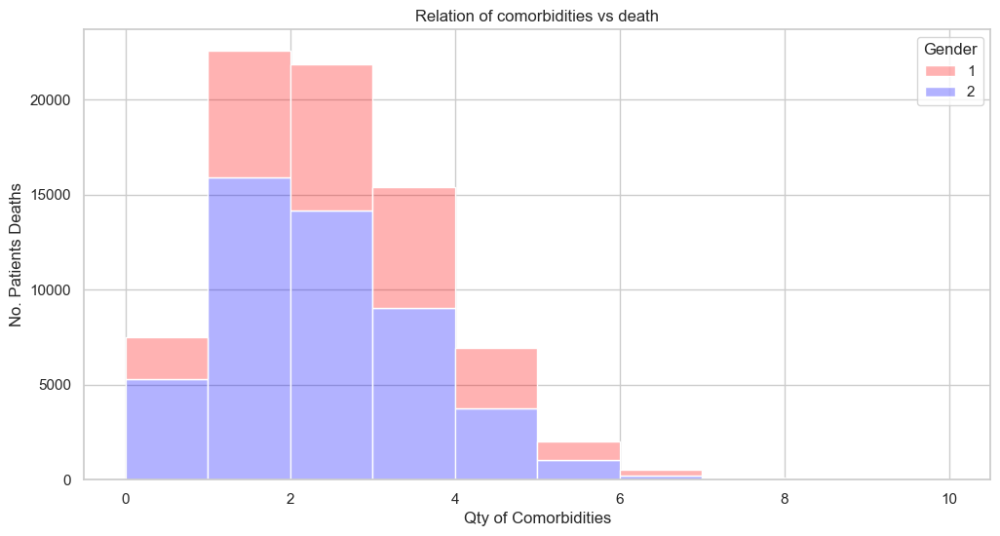

In [217]:
plt.ylabel('No. Patients Deaths')
plt.xlabel('Qty of Comorbidities')
plt.title('Relation of comorbidities vs death')
sns.histplot(data=deaths,
             x="Comorbidities",
             alpha=0.30,
             hue="Gender",
             multiple="stack", 
             binwidth=1,
             palette=['red', 'blue'],)

when we check the death by comorbidity and how it relates to entering a ICU it is visible that the great mayority of patients where not treated or escalated to intensive care.

<AxesSubplot:title={'center':'Relation of comorbidities deaths and ICU'}, xlabel='Qty of Comorbidities', ylabel='No. Patients Deaths'>

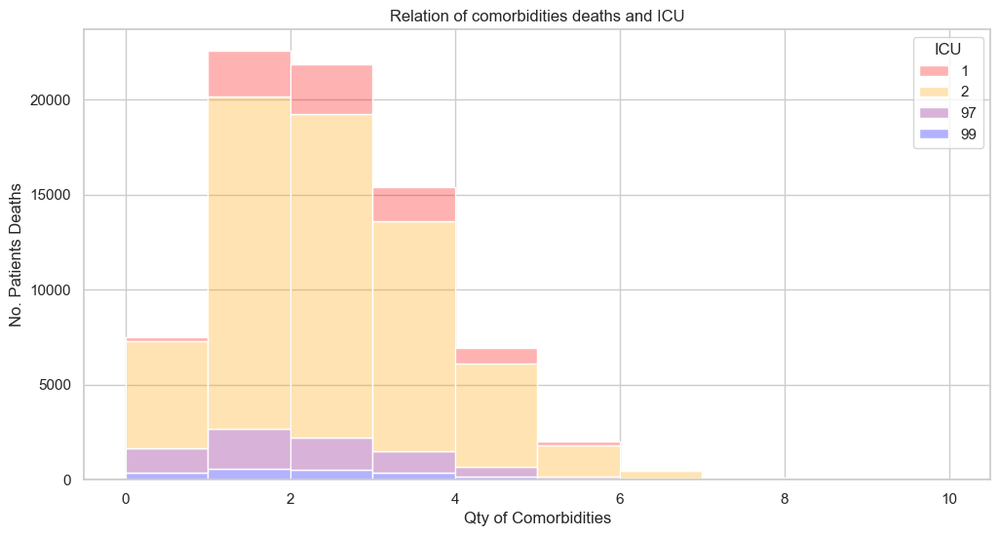

In [218]:
plt.ylabel('No. Patients Deaths')
plt.xlabel('Qty of Comorbidities')
plt.title('Relation of comorbidities deaths and ICU')
sns.histplot(data=deaths,
             x="Comorbidities", 
             hue="ICU",
             multiple="stack", 
             binwidth=1,
             palette=['Red', 'Orange', 'purple','Blue'],
             alpha=0.30)

1 in 4 patients that died where entubated:

<AxesSubplot:title={'center':'Relation of comorbidities deaths and Intubations'}, xlabel='Qty of Comorbidities', ylabel='No. Patients Deaths'>

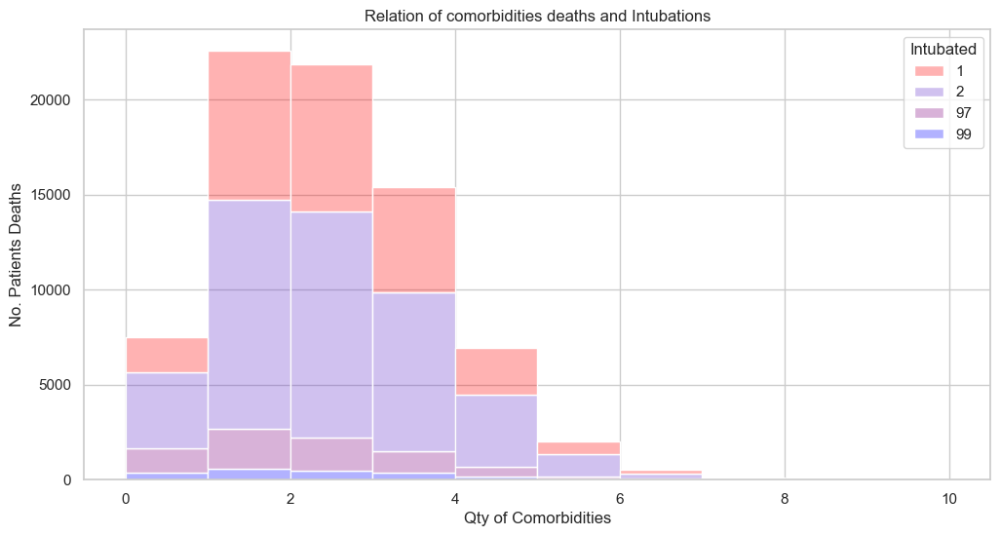

In [219]:
plt.ylabel('No. Patients Deaths')
plt.xlabel('Qty of Comorbidities')
plt.title('Relation of comorbidities deaths and Intubations')
sns.histplot(data=deaths,
             x="Comorbidities", 
             hue="Intubated",
             multiple="stack", 
             binwidth=1,
             palette=['red', '#6633cc', 'purple','Blue'],
             alpha=0.30)

# Mortality Rate by Age Group

lets look into the age groups and what group whas the most infected vs what age group had the higher mortality rate. as seen in the graphs bellow, the graphs skew to the left indicating that the younger ages where the most infected that asisted to the hospital. 69.32% of the patients where under the age of 50 nontheless, out of remaining 30.68% that where over the age of 50 we can see there is a higher mortality rate. 77.57% of the deaths where of patients that had over 50 years age. 

In [220]:
fig = px.histogram(coviddb, x="Age", nbins=25)
fig.update_layout(bargap=0.1) #nbins=20
fig.show()

In [221]:
fortyandup =coviddb.loc[coviddb.Age < 50]
fortyandup_count = fortyandup.shape[0]
round((fortyandup_count/totalsample) * 100,2)

69.32

In [222]:
fig = px.histogram(deaths, x="Age", nbins=25)
fig.update_layout(bargap=0.1) #nbins=20
fig.show()

In [223]:
mortality_fortyandup =deaths.loc[deaths.Age > 50]
mortality_fortyandup_count = mortality_fortyandup.shape[0]
round((mortality_fortyandup_count/deathtoll) * 100,2)

77.57

In [224]:
coviddb["DeathCount"] = [2 if each=="9999-99-99" else 1 for each in coviddb.DeathDate]

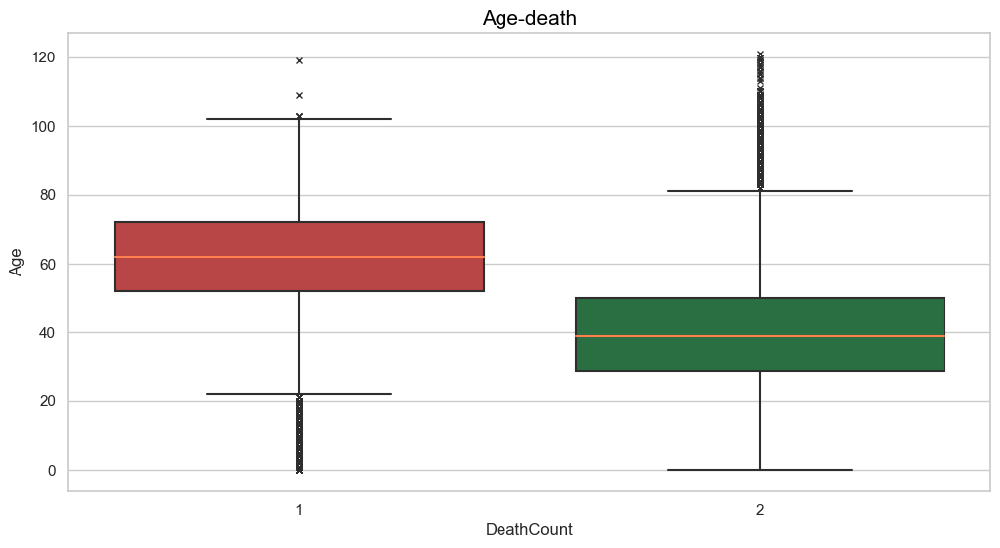

In [225]:
sns.boxplot(x="DeathCount", y="Age",data=coviddb,
            palette=sns.color_palette(["#ff0000","#009933"]),
            saturation=0.45,
            flierprops={"marker": "x"},
           medianprops={"color": "coral"})
plt.title("Age-death",fontsize=15, color="Black");

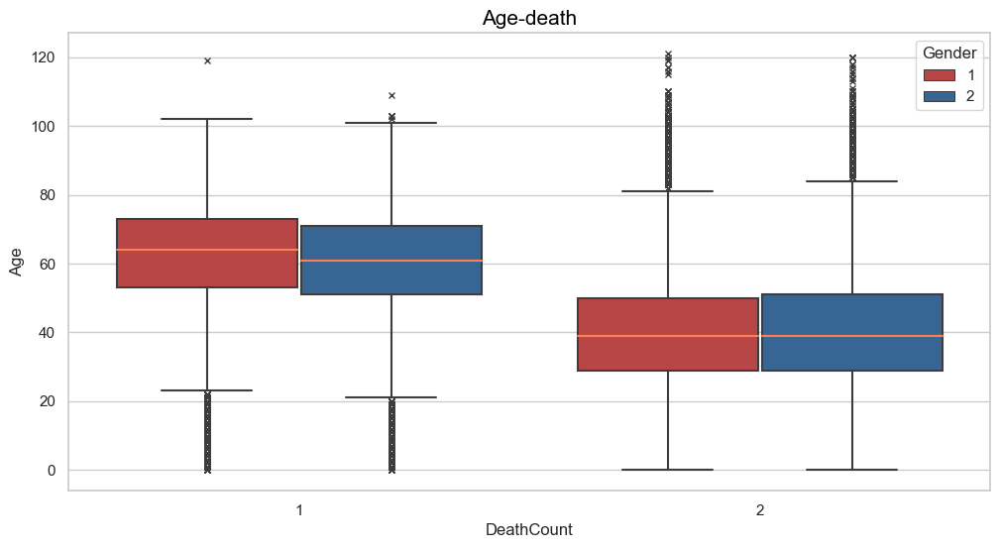

In [226]:
sns.boxplot(x="DeathCount", y="Age", hue="Gender",data=coviddb,
            palette=sns.color_palette(["#ff0000","#0066cc"]),
            saturation=0.45,
            flierprops={"marker": "x"},
           medianprops={"color": "coral"})
plt.title("Age-death",fontsize=15, color="Black");

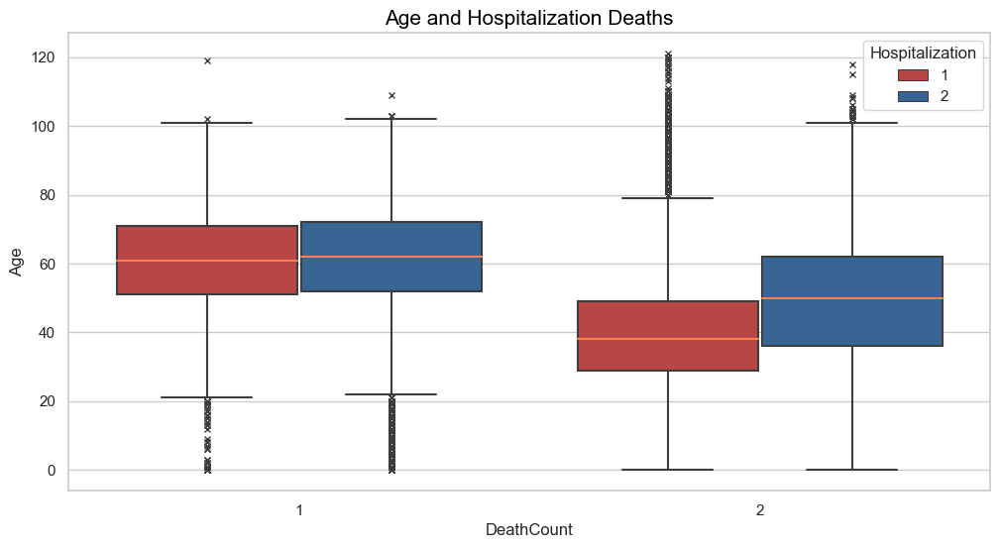

In [227]:
sns.boxplot(x="DeathCount", y="Age", hue="Hospitalization",data=coviddb,
            palette=sns.color_palette(["#ff0000","#0066cc"]),
            saturation=0.45,
            flierprops={"marker": "x"},
           medianprops={"color": "coral"})
plt.title("Age and Hospitalization Deaths",fontsize=15, color="Black");

<AxesSubplot:title={'center':'QTY of comorbidities, deaths by Age'}, xlabel='Qty of Comorbidities', ylabel='Age of Dead Patient'>

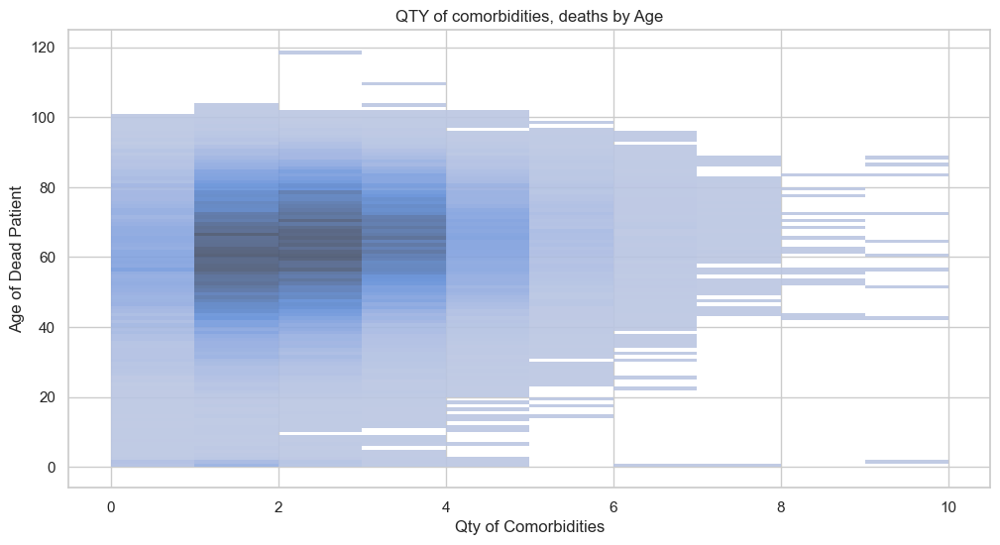

In [228]:
plt.ylabel('Age of Dead Patient')
plt.xlabel('Qty of Comorbidities')
plt.title('QTY of comorbidities, deaths by Age')
sns.histplot(data=deaths,
             x="Comorbidities", 
             y="Age",
             multiple="stack", 
             binwidth=1,
             palette='coolwarm',
             alpha=0.90)

<AxesSubplot:title={'center':'Covid Positive vs Negative Comorbities'}, xlabel='Qty of Comorbidities', ylabel='Diagnosed or not'>

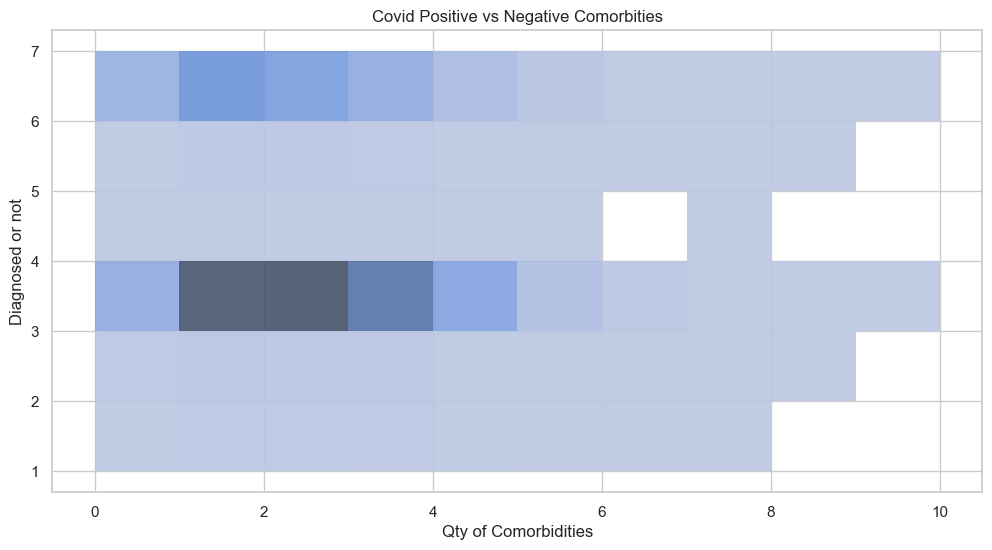

In [229]:
plt.ylabel('Diagnosed or not')
plt.xlabel('Qty of Comorbidities')
plt.title('Covid Positive vs Negative Comorbities')
sns.histplot(data=deaths,
             x="Comorbidities", 
             y="CLASIFFICATION_FINAL",
             multiple="stack", 
             binwidth=1,
             palette='coolwarm',
             alpha=0.90)

## corrolation between Variables

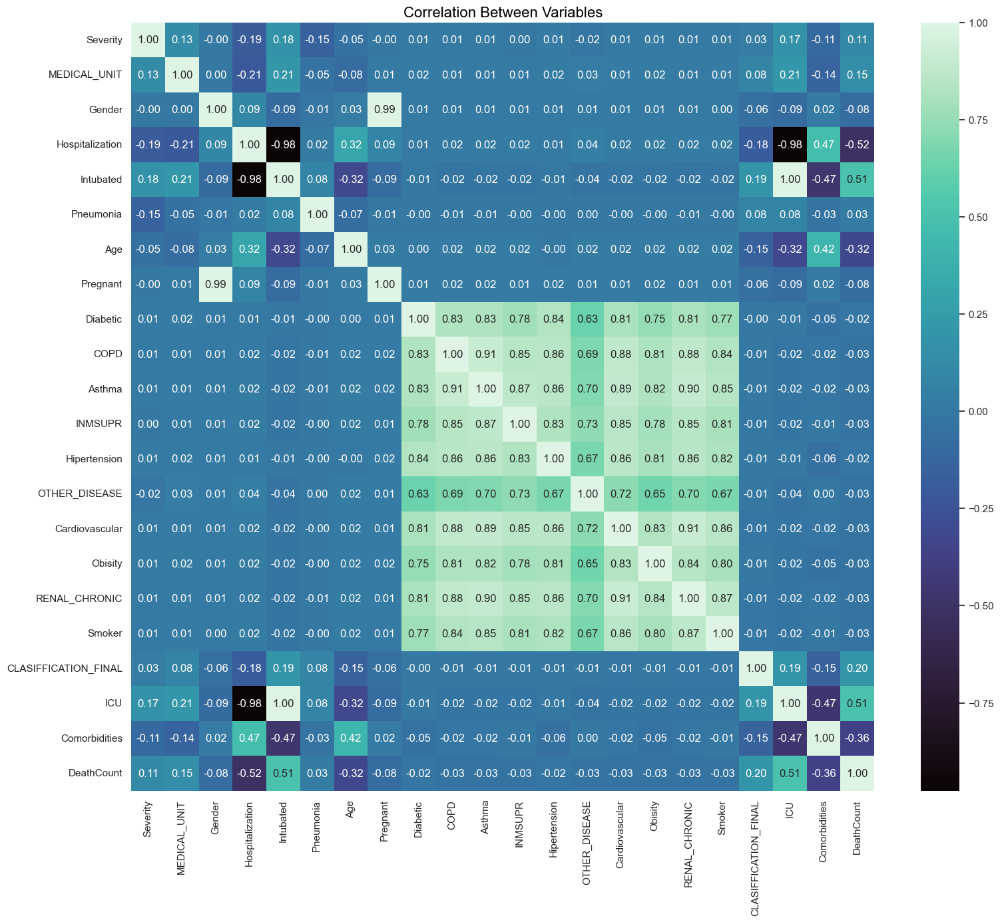

In [230]:
plt.figure(figsize=(18,15))
sns.heatmap(coviddb.corr(),
            annot=True,
            fmt=".2f",
            cmap="mako")
plt.title("Correlation Between Variables",fontsize=16,color="black");

# Most common Comorbities

In [231]:
QTY_comorb = coviddb[Comorbidities].replace(2.0, 0).replace(98, 0).replace(97, 0).replace(99, 0)

In [232]:
QTY_comorb["death"] = coviddb["DeathCount"]

In [233]:
QTY_comorb["Comorbidities"] = coviddb["Comorbidities"]

In [234]:
QTY_comorb.sample(5)

,Pneumonia,Diabetic,COPD,Asthma,INMSUPR,Hipertension,OTHER_DISEASE,Cardiovascular,Obisity,RENAL_CHRONIC,death,Comorbidities
309306,1,0,0,0,0,0,0,0,0,0,2,1
208263,0,0,0,0,0,0,0,0,1,0,2,1
264669,0,0,0,0,0,0,0,0,0,0,2,0
941355,0,0,0,0,0,0,0,0,0,0,2,0
151635,0,0,0,0,0,0,0,0,0,0,2,0


In [235]:
for i in Comorbidities:
        a = QTY_comorb[f"{i}"].sum()
        print(f"{i}"+" "+str(a) + " or " + str(round((a/totalsample)*100,2))+ "%")

Pneumonia 140038 or 13.36%
Diabetic 124989 or 11.92%
COPD 15062 or 1.44%
Asthma 31572 or 3.01%
INMSUPR 14170 or 1.35%
Hipertension 162729 or 15.52%
OTHER_DISEASE 28040 or 2.67%
Cardiovascular 20769 or 1.98%
Obisity 159816 or 15.24%
RENAL_CHRONIC 18904 or 1.8%


In [236]:
round((a/totalsample)*100,2)

1.8

In [259]:
patient_com = QTY_comorb.loc[QTY_comorb.Comorbidities >= 2]

In [260]:
patient_com.shape

(182587, 12)

In [264]:
survive_com = patient_com.loc[patient_com.death == 1]

In [265]:
survive_com.shape

(46850, 12)

In [267]:
46850/182587

0.2565900091463248

In [237]:
death_comorb = QTY_comorb.loc[QTY_comorb.death == 1]

In [238]:
death_comorb.sample(5)

,Pneumonia,Diabetic,COPD,Asthma,INMSUPR,Hipertension,OTHER_DISEASE,Cardiovascular,Obisity,RENAL_CHRONIC,death,Comorbidities
46265,0,0,0,0,0,1,0,0,0,0,1,1
56462,1,0,0,0,0,0,1,0,0,0,1,2
461915,1,1,0,0,0,0,0,0,0,0,1,2
334452,1,1,0,0,0,1,0,0,1,0,1,4
455980,0,1,0,0,0,1,0,0,0,0,1,2


In [239]:
for i in Comorbidities:
        a = death_comorb[f"{i}"].sum()
        print(f"{i}"+" "+str(a) + " or " + str(round((a/deathtoll)*100,2))+ "%")

Pneumonia 53923 or 70.08%
Diabetic 28265 or 36.74%
COPD 4021 or 5.23%
Asthma 1480 or 1.92%
INMSUPR 2618 or 3.4%
Hipertension 32061 or 41.67%
OTHER_DISEASE 4546 or 5.91%
Cardiovascular 4435 or 5.76%
Obisity 17294 or 22.48%
RENAL_CHRONIC 5707 or 7.42%


In [240]:
Comorb_deaths1 = death_comorb.loc[death_comorb.Comorbidities == 1]
Comorb_deaths2 = death_comorb.loc[death_comorb.Comorbidities == 2]
Comorb_deaths3 = death_comorb.loc[death_comorb.Comorbidities == 3]
Comorb_deaths4 = death_comorb.loc[death_comorb.Comorbidities == 4]
Comorb_deaths5 = death_comorb.loc[death_comorb.Comorbidities == 5]
Comorb_deaths6 = death_comorb.loc[death_comorb.Comorbidities == 6]
Comorb_deaths7 = death_comorb.loc[death_comorb.Comorbidities == 7]
Comorb_deaths8 = death_comorb.loc[death_comorb.Comorbidities == 8]
Comorb_deaths9 = death_comorb.loc[death_comorb.Comorbidities == 9]
Comorb_deaths10 = death_comorb.loc[death_comorb.Comorbidities == 10]

In [241]:
for i in Comorbidities:
        a = Comorb_deaths1[f"{i}"].sum()
        print(f"{i}"+" "+str(a) + " or " + str(round((a/deathtoll)*100,2))+ "%")

Pneumonia 15998 or 20.79%
Diabetic 1764 or 2.29%
COPD 235 or 0.31%
Asthma 97 or 0.13%
INMSUPR 171 or 0.22%
Hipertension 2170 or 2.82%
OTHER_DISEASE 480 or 0.62%
Cardiovascular 134 or 0.17%
Obisity 1349 or 1.75%
RENAL_CHRONIC 171 or 0.22%


In [242]:
for i in Comorbidities:
        a = Comorb_deaths2[f"{i}"].sum()
        print(f"{i}"+" "+str(a) + " or " + str(round((a/deathtoll)*100,2))+ "%")

Pneumonia 16653 or 21.64%
Diabetic 8183 or 10.64%
COPD 836 or 1.09%
Asthma 335 or 0.44%
INMSUPR 612 or 0.8%
Hipertension 9268 or 12.05%
OTHER_DISEASE 1182 or 1.54%
Cardiovascular 644 or 0.84%
Obisity 5217 or 6.78%
RENAL_CHRONIC 770 or 1.0%


In [243]:
for i in Comorbidities:
        a = Comorb_deaths3[f"{i}"].sum()
        print(f"{i}"+" "+str(a) + " or " + str(round((a/deathtoll)*100,2))+ "%")

Pneumonia 12747 or 16.57%
Diabetic 10218 or 13.28%
COPD 1142 or 1.48%
Asthma 426 or 0.55%
INMSUPR 676 or 0.88%
Hipertension 11824 or 15.37%
OTHER_DISEASE 1258 or 1.63%
Cardiovascular 1158 or 1.51%
Obisity 5124 or 6.66%
RENAL_CHRONIC 1600 or 2.08%


In [244]:
for i in Comorbidities:
        a = Comorb_deaths4[f"{i}"].sum()
        print(f"{i}"+" "+str(a) + " or " + str(round((a/deathtoll)*100,2))+ "%")

Pneumonia 6126 or 7.96%
Diabetic 5783 or 7.52%
COPD 931 or 1.21%
Asthma 307 or 0.4%
INMSUPR 531 or 0.69%
Hipertension 6284 or 8.17%
OTHER_DISEASE 888 or 1.15%
Cardiovascular 1239 or 1.61%
Obisity 3795 or 4.93%
RENAL_CHRONIC 1896 or 2.46%


In [245]:
for i in Comorbidities:
        a = Comorb_deaths5[f"{i}"].sum()
        print(f"{i}"+" "+str(a) + " or " + str(round((a/deathtoll)*100,2))+ "%")

Pneumonia 1816 or 2.36%
Diabetic 1748 or 2.27%
COPD 579 or 0.75%
Asthma 187 or 0.24%
INMSUPR 395 or 0.51%
Hipertension 1900 or 2.47%
OTHER_DISEASE 477 or 0.62%
Cardiovascular 826 or 1.07%
Obisity 1318 or 1.71%
RENAL_CHRONIC 869 or 1.13%


In [249]:
for i in Comorbidities:
        a = death_comorb[f"{i}"].sum()
        print(f"{i}"+" "+str(a) + " or " + str(round((a/deathtoll)*100,2))+ "%")

Pneumonia 53923 or 70.08%
Diabetic 28265 or 36.74%
COPD 4021 or 5.23%
Asthma 1480 or 1.92%
INMSUPR 2618 or 3.4%
Hipertension 32061 or 41.67%
OTHER_DISEASE 4546 or 5.91%
Cardiovascular 4435 or 5.76%
Obisity 17294 or 22.48%
RENAL_CHRONIC 5707 or 7.42%


# Summary of the Information

In [270]:
from pdf2image import convert_from_path
import easyocr
import numpy as np
import PIL
from PIL import ImageDraw
import spacy
import IPython

In [271]:
reader = easyocr.Reader(['es'])

CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.


In [275]:
images = convert_from_path('.\\Comorbidity Covid 19 - Mexico Data.pdf')

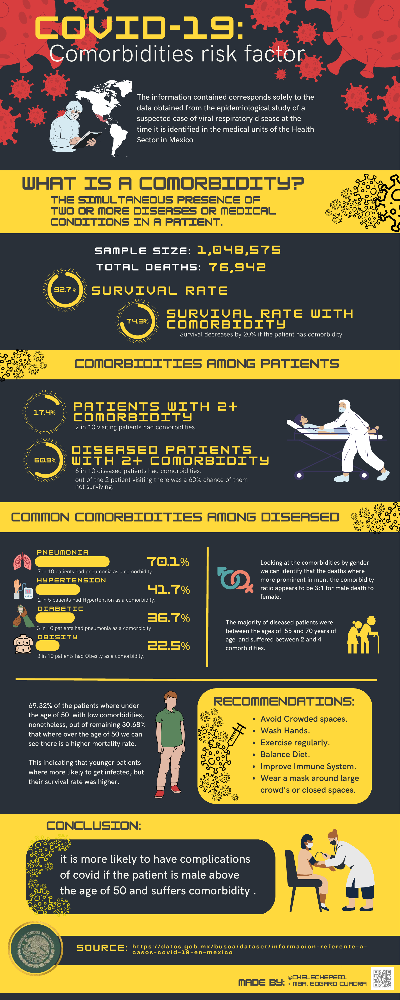

In [276]:
from IPython.display import display, Image
display(images[0])

In [269]:
# We can create a predictive model that we input our variables and patient characteristics 
# and it can indicate the probability of death by contracting Covid. 